<p><img style="padding: 0 15px; float: left;" src="FTLogo300.jpg" alt="FT Crusader Logo" Width='140' Height= '250'/></p> 
<p> <h2> 311 Blocked Bike Lane Requests Exploratory Analysis; Updated 1/1/25</h2>
<p> <h3> By Abu Nayeem (anayeem1@gmail.com); published 12/6/24 

[Sustainabu GitHub Link](https://github.com/sustainabu/OpenDataNYC)

# Table of contents <a name="content"></a>
* [Purpose](#d0)
* [About the Data](#d1)
* [Descriptive Statistics](#d2)
  * [Borough Service Overview](#d2a)
  * [Borough Community Board Overview](#d3)
  * [Temporal Analysis](#d5)
* [NYPD Response Breakdown](#d6)
  * [NYPD Response Breakdown by Borough](#d7)
* [NYPD Response Time Breakdown (Unbinned)](#d8)
  * [NYPD Response Time Breakdown (binned)](#d9)
  * [NYPD Response Time Breakdown by Borough (binned)](#d10)
  * [NYPD Response Time Breakdown by Resolution (binned)](#d11)
* [Call Density Analysis](#c1)
  * [Call Density by Borough](#c2)
  * [Call Density by NYPD Response](#c3)
  * [Call Density by NYPD Response Time](#c4)
* [Geo-Spatial Analysis](#d13)
  * [NYPD InAction Rate Density Map (Interactive)](#d14)
  * [NYPD Median Response Density Map (Interactive)](#d14a)
  * [NYPD Response Bubble Map (Interactive)](#d15)
  * [NYPD Median Response Time Bubble Map (Interactive)](#d16)
  * [311 Blocked Bike Lane Data Dashboard](#d17)
* [Conclusion](#d18)
* [Next Steps](#d19)
* [Programmer Notes](#d20)
* [Run Code](#dend)

# Purpose <a name="d0"></a>

I’m a Queens native, and a cyclist. I’m greatly appreciative of the existing bike infrastructure in Queens, but the frequency of obstruction and lack of enforcement within bike lanes are frustrating and life-threatening. It should not be the case that cyclists are risking their life when riding their bike even with dedicated lanes. NYC has a 311 reporting system to report violations, which the NYPD enforces. 

However, recent studies have shown the NYPD are doing an inadequate job with <u>[only 2% of service requests receiving summons compared to 16% of other similar complaints](https://nyc.streetsblog.org/2023/04/06/nypd-tickets-fewer-than-2-of-blocked-bike-lane-complaints-analysis)</u>. In 2021, Streetblogs did <u>[an investigative report](https://nyc.streetsblog.org/2021/10/21/ignored-dismissed-how-the-nypd-neglects-311-complaints-about-driver-misconduct)</u> highlighting the sharp increase of NYPD unrealistic response time of less than five minutes as shown in the graph below. Finally, in 2024, there was <u>[a surveillance study](https://nyc.streetsblog.org/2024/10/29/study-exposes-nypds-systemic-failure-to-enforce-safety-related-parking-violations)</u> using AI to empirically verify the lack of police enforcement, and false reporting in the service 311 records.

![Fig0.1](Screenshots/Fig0.png)

This exploratory report reviews 311 service request data for Blocked Bike Lane violations within the last two years (starting January, 1st, 2023) to provide baseline insight, highlight inequities, and provide the tools for community members to take action. I’ve created an **<u>[INTERACTIVE data dashboard](https://sustainabu.shinyapps.io/blockedbikelanedashboard/)**</u> to monitor progress and hold local enforcement. I provide some recommendations at the end to address this issue, including my interest to build a civic-tech app that crowds-source validation to increase transparency and hold NYPD accountable.


**Why does adequate enforcement of blocked bike lanes incidents matter?**
* Unlike vehicle-drivers, cyclists can face severe bodily harm if there is a vehicle collison. Obstruction can force cyclists to veer into a vehicle lane. Vehicle drivers may not be paying attention and/or willful negligence.
* Unsafe bike trips lead to less ridership.
* Lack of enforcement encourage violators.
* Misallocations of public funds [i.e. invest in infrastructure without basic safety.

**How does NYPD prioritize blocked bike lanes requests?**
* These are low-priority requests, but it's still required for NYPD to review them. Within a police precinct, the increased frequency of higher-priority crimes and traffic violations may lead to slower response times.
* Bike lane obstruction is expected to be fleeting. A prolonged NYPD response may lead them to be too late to catch violator. Multiple requests could encourage urgency.

# About the Dataset: <a name="d1"></a>

The dataset, <u>[311 Service Requests from 2010 to Present](https://data.cityofnewyork.us/Social-Services/311-Service-Requests-from-2010-to-Present/erm2-nwe9/about_data)</u> was obtained from NYC Open Data Portal. The report covers data from January 1st, 2023 to December 6th, 2024. Each record is a 311 blocked bike lane service request, which is handled by the NYPD. The NYPD is expected to investigate the request, and can give the violator a warning, summon (i.e. ticket), or take no-action. Once a resolution is made, the request is closed and registered in 311. The **police response time** is the time elapsed between the opening & closing of the request. 

Here is the **list of resolution, frequency, and classification** for the last two years:

![Fig2.1](Screenshots/T_Final.png)


**Is there variation of biking infrastructure in NYC?**
* There is extensive and varying biking infrastructure within Manhattan, Brooklyn, and parts of Bronx, and Queens. You can view the <u>[NYC bike map](https://www.nyc.gov/html/dot/downloads/pdf/nyc-bike-map-2024.pdf)</u>.
* For this report, I did not classify/ evaluate the impact of different cycling infrastructure.

**Is the data reliable?**
* Only reported service requests are shown in the dataset. There can be many **unreported** blocked bike lane violations. Several reasons include: inconvenience, lack of time, intimidation from violators, and infractions may be committed by NYPD.
* There is **no external validation** that the NYPD physically investigated the request. In addition, the dataset does not include reason for non-action or specify what action was taken. However, they are required to close the request. 
* It is possible that there may be "double-counting" where multiple service requests can be made for the same violation. I've created a **call-density** term. Read the section carefully on how it can impact the overall statistics.
* A geo-validation method was used to link to police precinct. Roughly speaking, most police-precincts and community-board boundaries match.

**How were the 311 service requests made?**
* About 60% of request were made online, 38% via phone app, and 2% over the phone.

**Data Prep Decisions:**
* The data is updated daily, and I excluded any "open" status service requests and requests not geo-located to any borough or community board.
* The NYPD response was broken down to "MinutesElapsed" and placed into bins.


# Descriptive Statistics <a name="d2"></a>

## Borough Service Overview <a name="d2a"></a>

![Fig1.1](Screenshots/F1_all.png)

## NYC Borough Community Board (CB) Overview <a name="d3"></a>

* For Manhattan, service requests are distributed more evenly. CB3 has the most requests (19%) followed by CB10 (14%).
* For Brooklyn, service requests are distributed unevenly. CB2 has the most requests (42%) followed by CB6 (24%).

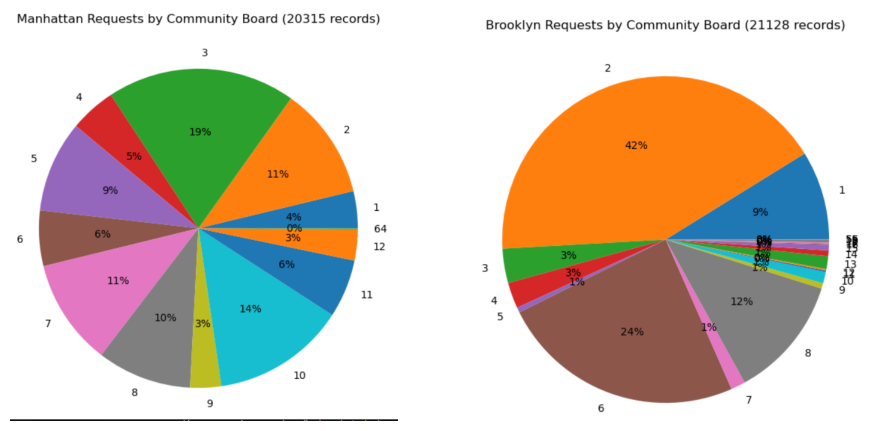

array([<Axes: >, <Axes: >], dtype=object)

In [12]:
SideImage('Screenshots/F2_Man.png','Screenshots/F3_Brook.png')

* For Queens, CB2 has the most requests (47%) followed by CB1(14%).
* For Bronx, CB5 covers 52% of all service requests with the remainder distributed more evenly.

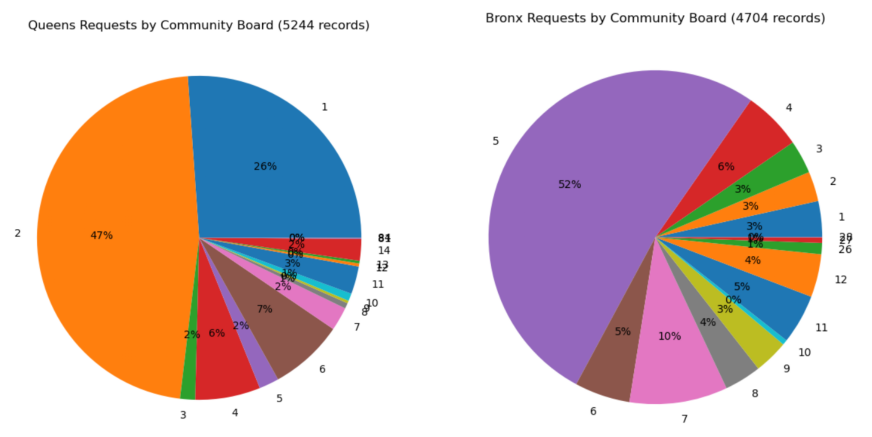

array([<Axes: >, <Axes: >], dtype=object)

In [13]:
SideImage('Screenshots/F4_Queens.png','Screenshots/F5_Bronx.png')

## Temporal Analysis <a name="d5"></a>
 
* Compared to previous year, there is less service requests except during the summer months.
* There is seasonal variance with a drop during the summer months. I speculate that it could be related to school not being in session, and less vigilance.

![Fig2.3](Screenshots/F6_Time.png)

* There are nearly twice more service requests during the weekday than the weekend. Wednesday has the most service requests.
* Service requests peak around rush hour times: 8AM, 2PM, and 6PM.

array([<Axes: >, <Axes: >], dtype=object)

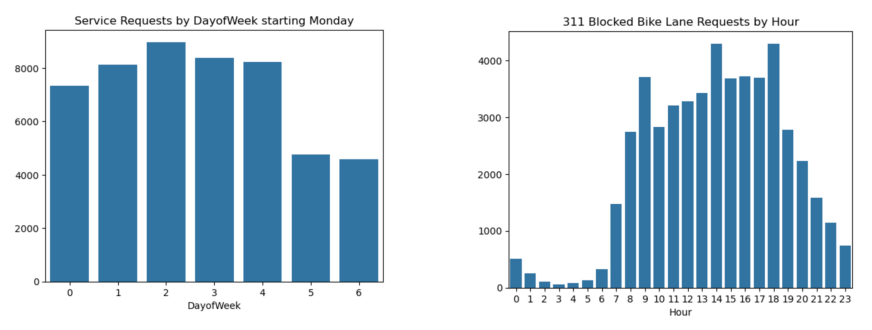

In [4]:
SideImage('Screenshots/F7DayofWeek.png','Screenshots/F8Hour.png')

# NYPD Response Breakdown of Service Requests <a name="d6"></a>

* As explained in the data section, NYPD responses were categorized into [Miss, Pass, Action, and Summon].
* About 30% of service requests led to enforcement.

![Fig3.1](Screenshots/F9_Response.png)

## NYPD Response Breakdown by Borough <a name="d7"></a>

* For Bronx, about 22% of service requests led to enforcement though increased number of summons
* For Brooklyn and Bronx, they follow closely to the average.
* For Queens, about 40% of service requests led to enforcement.

![Fig4.1](Screenshots/G1_Responses.png)

# NYPD Response Time Breakdown (Unbinned) <a name="d8"></a>

* Note: Response times considers once the entire interaction with the violator is completed. If the violator is present, the response time should be longer.

![Fig6.1](Screenshots/F10Elapse.png)

## NYPD Response Time Breakdown (binned) <a name="d9"></a>

* Nearly 2/3 of all service requests are resolved within 1 hour.
* At the extremes, 5% of service requests are resolved within 5 minutes, while 3% of service requests are resolved after 6 hours.

![Fig7.1](Screenshots/F12_ElapseBin.png)

## NYPD Response Time Breakdown by Borough (binned) <a name="d10"></a>

* For Bronx, 57% of responses took at least over 1 hour with 11% taking over 6 hours.
* For Queens, 42% of response took at least over 1 hour.
* Manhattan has the most favorable response times with only 21% of response took at least over 1 hour.

![Fig8.1](Screenshots/T1_RespBo.png)

## NYPD Response Time Breakdown by Resolution (binned) <a name="d11"></a>

* When summons were given, over 40% of requests were within 1 to 6 hour response time. I predict that it's likely the result of multiple persons filling a service request for the same violator. In addition, the process of writing a summons and discourse with violator can increase response time.
* When NYPD took "Action" against the violator, they had faster response times even considering extra time for dialogue.
* When NYPD "Miss" the violators, 40% of the time they investigated at least one hour or longer.
* When the NYPD took "No-Action", 7% of service requests were completed in 5 minutes or less. This seems suspicious.

![Fig9.1](Screenshots/T2_RespRes.png)

# Call Density Analysis <a name="c1"></a>

Suppose there is an obstruction in one location, and four citizens placed a separate 311 request at different times. The NYPD arrived at the scene and cleared out all the requests (starting from last entry). For this obstruction, the “call-density” was 4 and should the NYPD get "credit" for responding to the same request (i.e. double-counting)? The following table below captures the information above (columns in blue is bare data).

![Fig8.1](Screenshots/TDensityEx.png)

Notice the following:
* The latest entry is closed first, and the preceding entry closes dozens of seconds later.
* The later entries have quicker response times. 
* It cannot be determined if the violation from the 1st requester is the same as the 2nd requester.

### Data Strategy

* I used a discrete 4-minute bin on the closing time to determine **call-density**.
  * Information can be lost within the boundary effects. For example, if the 4th entry was closed at 9:54.30 AM, the call-density would change.
  * "Nearest Neighbor" binning would provide a better fit (i.e. a radius ball around each closing). Pandas does not provide an immediate solution, and not worth the effort for marginal gains as underlying data is messy.
* The call-density analysis only keeps the first entry (blue outline), and discards the remainder entries. My base assumption is that the first entry accurately captures NYPD response time and the call-density information is still maintained. This datatable is not the default due to inherent information-loss from binning.
* The skewed call-density analysis keeps the final entry of the density pool (red outline). It highlights the skewness of these entries in the raw dataset.



## Call Density by Borough <a name="c2"></a>

* Compared to the original dataset, Brooklyn has greater call-density distribution.
* Queens has increased distribution for call-density 5 or more calls from (6% to 14%).
* Manhattan is under-represented with respect to call-density.

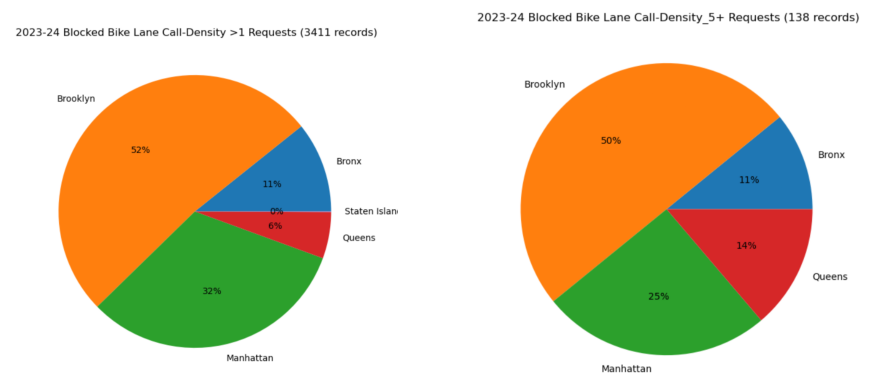

array([<Axes: >, <Axes: >], dtype=object)

In [10]:
SideImage('Screenshots/PDensity1.png','Screenshots/PDensity5.png')

## Call Density by NYPD Response <a name="c3"></a>

* Compared to the raw dataset, about 8% to 10% of entries are 'double-counted'.
* For greater call-density, the NYPD is less likely to be 'Late', and take more 'Action'.

![Fig8.1](Screenshots/TDensityRes.png)

## Call Density by NYPD Response Time <a name="c4"></a>

* With increased call-density there is decrease of response times greater than six hours.
* Generally, the average response times have improved with call density.
* With increased call-density there is an increase of response times between one hour to six hours, which is counter-intuitive. One explanation could be the increased enforcement led to longer closing time.
* For Call-Density (4 and greater), it's extremely unlikely response times between 0 to 5 mins were possible without NYPD prematurely closing it.
  * In practice, this would mean a citizen reporting the incident every minute (with physical overlap), and NYPD arriving and evaluating within about less than a minute from what citizens believe is clear-violation.
  * It's possible the violator could be another NYPD or city-vehicle and responding officer ignored it outright.

![Fig8.1](Screenshots/TDensityReg.png)

* The **Skewed Call-Density** Table below shows an increased proportion of the latest request being closed between 0 to 5 minutes. This suggests that a large portion of requests completed within that time-frame is a result of officers arriving at the scene already. This is in-addition to the foul play possibilities from previous table.
  
![Fig8.1](Screenshots/TDensitySkew.png)

# Geo-Spatial Analysis  <a name="d13"></a>


## NYPD InAction Rate Density Map by Police Precinct (Interactive) <a name="d14"></a>

The **inaction rate** is simply the rate that NYPD took no action (i.e. Late or No-Action). HOVER for more details including hotspot.

<div class="flourish-embed flourish-map" data-src="visualisation/21004828"><script src="https://public.flourish.studio/resources/embed.js"></script><noscript><img src="https://public.flourish.studio/visualisation/21004828/thumbnail" width="100%" alt="map visualization" /></noscript></div>

## NYPD Median Response Time Map by Police Precinct (Interactive) <a name="d14a"></a>

* HOVER for more details including on hotspot.

<div class="flourish-embed flourish-map" data-src="visualisation/21004772"><script src="https://public.flourish.studio/resources/embed.js"></script><noscript><img src="https://public.flourish.studio/visualisation/21004772/thumbnail" width="100%" alt="map visualization" /></noscript></div>

## NYPD Blocked Bike Lane Service Response Bubble Map (Interactive) <a name="d15"></a>

* **Note:** The color indicates increased frequency, and the scale was balanced to increase visibility.
* **Scale:** Green: 5 or less; Orange: 5 to 25; Purple: 25+
* **ON Click**: NYPD Response.

In [22]:
Bub_CB()

## NYPD Median Response TIME Bubble Map (Interactive) <a name="d16"></a>

* **Legend:** The color indicates median response time. Green: =< 30 mins; Orange: 30 to 60 mins; Red: > 60 mins
* **Scale:** All locations must have at least six entries.
* **ON Click:** Median Response and Response Distribution
* Some areas of Brooklyn, Queens, and Bronx are deeply concerning where there is greater frequency of violations, and slow police response time.

In [24]:
Bub_Med()

## 311 Blocked Bike Lane Dashboard <a name="d17"></a>

With the dashboard you can select date range, select community board, and monitor existing police responses. It's best viewed on desktop screen <u>[CLICK HERE for DashBoard](https://sustainabu.shinyapps.io/blockedbikelanedashboard/)</u> 

![Fig7.1](Screenshots/Tapp2.png)


# Summary/ Conclusion <a name="d18"></a>

From the data analysis, there is reason for citizens to be concerned about NYPD enforcement of blocked bike lane requests. 
* The NYPD enforces only 30% of service requests.
* About 8-10% of 311 requests are double-counted with more favorable response times
* For call-density 4 or greater, the NYPD is still responding without taking meaningful action for about 5% of instances.
* For resolutions where NYPD took no action, 7% of requests were responded in 5 minutes or less, varying greatly from the average. This is suspicious.
* When NYPD issues a verifiable summons, only 1% of requests were responded in 5 minutes or less, and often responded later.
* When NYPD "misses' the violator, their response time is considerably slower than all actions.
* Comparing boroughs, NYPD response time for Manhattan is better across the board. For the Bronx, and Queens, the response times are very slow.
* From the maps, there are hotspots within a neighborhood of sub-par NYPD response that communities can focus on.


 **How do we measure improved progress of NYPD enforcement?**

The most obvious metric is reducing NYPD response time. This goal is easy to achieve if they don't actually review the violation. They can falsely review requests earlier and provide a "No-Action" or "Miss" resolution, to reduce their recorded response time. This coincides with previous investigative reporting. The data corroborates foul behavior by the stark difference of response times where summons (confirmable resolution) were given. 

**Here are three recommendation strategies:**
1) **Administrative:** New administrative leadership prioritizing cutting down poor practices. This could create short-term change, but can revert to the previous state. This is not sustainable.
2) **Geo-validation:** Since traffic violations are location-specific, it could be required for the responding personnel to geo-validate when confirming their investigation. This process assures "ghost" enforcements are not made, but cannot confirm if proper enforcement was taken.
3) **Crowd-Source Validation:** This process involves citizens (i.e. crowd) to verify law enforcement. Citizens would file a 311 request, and enter data independently through an app. From the discrepancy between the 311 request and crowd-source data, citizens can hold local law enforcement accountable. I'm interested in creating a civic-tech app. If you are a developer, biking/ transit advocate, let’s connect. 


# Next Steps/ Opportunities <a name="d19"></a>
* Partner with local community organizations for an intentional campaign to improve biking violation enforcement. You can measure real-time progress with community dashboard.
* A dedicated team to build a civic tech app and launch in appropiate community.
* Data Request: If anyone has a geo-validation method to link geo-coordinates to NYPD police precincts, this will greatly expand precision, and analysis.
* Contact me: anayeem1@gmail.com

# Programmer Notes <a name="d20"></a>

### 12/14/24 Update
* Able to access police precincts. Police precincts and community board boundaries are nearly 1 to 1
* Created a midpoint algoritm to set zoom at optimal location. Manual dataframes is no longer needed
* For adjustable bubble maps, I removed the creation of columns by pivot table, because crash of missing data. Instead used dummy count.
* Within shiny app, I added as much customization without breaking the app. There was no simple solution adjusting the column row.
* Within shiny app, I removed three pieces where info seemed bare. Added a summary table, history line chart, and only median response time graph
   * Another piece could be added about distribution of resolutions but nothing seemed intutive
* Chat GPT has been a huge asset in making adjustments
* Updated Flourish graphs, and points; included many
* The QA testing seems pretty decent; I have not tested in very scarce communities
* A visual freshup can be helpful. I don't think ChatGPT can help, and it seems good enough for basic functionality

### 12/19/24 Update
* Report Edits: Added "InAction" Rate Map, and removed the intensive geo-mapping code. Flourish seemed better.
* I tried to use StreamLit as alternative python dashboard. It was quite bad as it cannot handle data pulls, and it was hard to set up
* I did an overhaul for community dashboard making it more mobile-friendly. A few notes:
   * A lot of edits for reducing space so title are displayed for graphs. Corrections were made to remove menu coming up when click
   * The menu format was finally selected to reduce information overload on screen
   * SHINY is designed primarily for Desktop, not Mobile
   * Chat GPT hallucinated frequently
   * I try to build the app from custom, and given up as the web development is confusing because there are two packages SHINY, and SHINY
   * Chat GPT- It hallucinates to provide a solutions and then hallucinate again to come up with alternative
   * Things that cannot be adjusted: Horizontal Scroll-bar and expanding output for folium map

### 1/1/25 Update
* Report Edits: Updated all table for the end of the year.
* Added Call-Density Analysis and Section 
* Replaced Resolution Miss with Late category
* App: Added a Welcome page looking for Feedback
* App: Added a Call-Density Chart
* App: Added a Call-Density Table
* Updated Florish Graphs with Info
* Error Spot: There are some distinct addresses that share the same same coordinates as seen from flourish point. [ check difference  of address and UADD 1925 7 Avenue] The UADD is not a unique address identifier
  

# Run Code <a name="dend"></a>

In [21]:
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings('ignore')
import json
from urllib.request import urlopen
from IPython.display import HTML
from IPython.display import display
import requests # library to handle requests
import folium
import seaborn as sns
from plotly import graph_objects as go
import plotly.express as px
import geopandas
import branca

#Placing Side by side Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from matplotlib import rcParams
import os


def SideImage(Img1, Img2):
    # Ensure figure size is set
    rcParams['figure.figsize'] = (11, 8)
    
    # Load images
    try:
        img_A = mpimg.imread(Img1)
        img_B = mpimg.imread(Img2)
    except FileNotFoundError as e:
        print(f"Error: {e}")
        return None

    # Create side-by-side subplots
    fig, ax = plt.subplots(1, 2)
    
    # Display first image
    ax[0].imshow(img_A)
    ax[0].axis('off') 
    
    # Display second image
    ax[1].imshow(img_B)
    ax[1].axis('off')
    
    # Show the plot
    plt.show()
    
    return ax

#regular coding
#1.Read local files 
#dataframe
df = pd.read_csv("dfc_out.csv")
df.cboard=df.cboard.astype(int)
print(df.shape)



def Bub_CB(CB="All"):
    if CB=="All":
        B=df 
        zo= 11.25
        default_location = [40.7128, -74.0060]
    else: 
        B= df[(df['cboard'] == CB)]
        zo=13   

    
    # Find Midpoint of Latitude and Longitude of all points
    LaMax=B.latitude.max()
    LaMin=B.latitude.min()
    Latitude=(LaMax+LaMin)/2
    LoMax=B.longitude.max()
    LoMin=B.longitude.min()
    Longitude=(LoMax+LoMin)/2

    # Use default location for "All"
    if CB == "All":
        map_location = default_location
    else:
        map_location = [Latitude,Longitude]
    
    # generate a new map
    FG_map = folium.Map(location=map_location, zoom_start=zo,tiles="CartoDB positron") #tiles="OpenStreetMap")
    
    Index =['incident_address','longitude','latitude', "index_",'Late','No-Action','Action','Summon']
    B17=B[Index].groupby(['incident_address','longitude','latitude']).sum().reset_index()
    # Less than 5 count
    BA=B17.query('index_<=5')
    for index, row in BA.iterrows(): 
        popup_text = "Address: {}<br> Total: {}<br> NYPD_Late: {}<br> NYPD_No-Action: {}<br> NYPD_Action: {}<br> NYPD_Summons: {}"
        popup_text = popup_text.format(row['incident_address'],row['index_'], row["Late"],row['No-Action'], row['Action'], row['Summon'])
        folium.CircleMarker(location=(row["latitude"],row["longitude"]),
                            radius=row['index_'] +2,
                            color="#007849",
                            popup = folium.Popup(popup_text, max_width=300),
                            fill=True).add_to(FG_map)
    # Between 5 and 25 count
    BB=B17.query('index_<=25 and index_>5')   
    for index, row in BB.iterrows(): 
        popup_text = "Address: {}<br> Total: {}<br> NYPD_Late: {}<br> NYPD_No-Action: {}<br> NYPD_Action: {}<br> NYPD_Summons: {}"
        popup_text = popup_text.format(row['incident_address'],row['index_'], row["Late"],row['No-Action'], row['Action'], row['Summon'])
        folium.CircleMarker(location=(row["latitude"],row["longitude"]),
                            radius=row['index_']/5 +7,
                            color="#E37222",
                            popup = folium.Popup(popup_text, max_width=300),
                            fill=True).add_to(FG_map)
    # Greater than 25 count
    BC=B17.query('index_>25')
    for index, row in BC.iterrows(): 
        popup_text = "Address: {}<br> Total: {}<br> NYPD_Late: {}<br> NYPD_No-Action: {}<br> NYPD_Action: {}<br> NYPD_Summons: {}"
        popup_text = popup_text.format(row['incident_address'],row['index_'], row["Late"],row['No-Action'], row['Action'], row['Summon'])
        folium.CircleMarker(location=(row["latitude"],row["longitude"]),
                            radius=row['index_']/15 +12,
                            color="#800080",
                            popup = folium.Popup(popup_text, max_width=300),
                            fill=True).add_to(FG_map)        

    
    title_html = f"""
         <div style="
            position: fixed; 
            top: 5px; 
            left: 50%; 
            transform: translateX(-50%);
            z-index: 1000;
            font-size: 18px; 
            font-weight: bold;
            background-color: yellow; 
            padding: 5px 10px; 
            border-radius: 5px; 
            box-shadow: 0 2px 5px rgba(0, 0, 0, 0.5);">
            Blocked Bike Lane Service Requests (Interactive)
         </div>
         """
    FG_map.get_root().html.add_child(folium.Element(title_html))

    source_html = f"""
         <div style="
            position: fixed; 
            bottom: 5px; 
            left: 12%; 
            transform: translateX(-50%);
            z-index: 1000;
            font-size: 18px; 
            font-weight: bold;
            background-color: #D3D3D3; 
            padding: 5px 10px; 
            border-radius: 5px; 
            box-shadow: 0 2px 5px rgba(0, 0, 0, 0.5);">
            Source: <a href="https://data.cityofnewyork.us/Social-Services/311-Service-Requests-from-2010-to-Present/erm2-nwe9/about_data/" target="_blank">311 Service Requests</a>
         </div>
         """
    FG_map.get_root().html.add_child(folium.Element(source_html))
    
    return FG_map 



def Bub_Med(PP="All"):
    if PP=="All":
        Z=df 
        zo= 11.25
        default_location = [40.7128, -74.0060]
    else: 
        Z= df[(df['precinct'] == PP)]
        zo=13

    # Find Midpoint of Latitude and Longitude of all points
    LaMax=Z.latitude.max()
    LaMin=Z.latitude.min()
    Latitude=(LaMax+LaMin)/2
    LoMax=Z.longitude.max()
    LoMin=Z.longitude.min()
    Longitude=(LoMax+LoMin)/2

    # Use default location for "All"
    if PP == "All":
        map_location = default_location
    else:
        map_location = [Latitude,Longitude]
    
    # generate a new map
    FG_map = folium.Map(location=map_location, zoom_start=zo,tiles="CartoDB positron") #tiles="OpenStreetMap")

    #Prepare Data
    p=['incident_address','UAdd','longitude','latitude','index_',"min0->5","min5->30", "min30->60", "min60->360","min360+",'Late','No-Action','Action','Summon']
    df1=Z[p].groupby(['incident_address','UAdd','longitude','latitude']).sum().reset_index()
    # to get median
    p2=['UAdd','MinutesElapsed']
    C=Z[p2].groupby(['UAdd']).median().reset_index()
    C.columns= ['UAdd','Median_Minutes']   
    C1= pd.merge(df1, C, on='UAdd', how='right') 
    # to get meean
    p2=['UAdd','MinutesElapsed']
    C2=Z[p2].groupby(['UAdd']).mean().reset_index()
    C2.columns= ['UAdd','Mean_Minutes']   
    D= pd.merge(C2, C1, on='UAdd', how='right') 

    D['Median_Minutes']= round(D['Median_Minutes'],2)
    D['Mean_Minutes']= round(D['Mean_Minutes'],2)

    B17= D.query('index_>3')

    # Median less than 30
    BA=B17.query('Median_Minutes<=30')
    for index, row in BA.iterrows(): 
        popup_text = "Address: {}<br> Total: {}<br> MedianMin: {}<br> MeanMin: {}<br> Min0->5: {}<br> Min5->30: {}<br> Min30->60: {}<br> Min60->360: {}<br> Min360+: {}<br> NYPD_Late: {}<br> NYPD_No-Action: {}<br> NYPD_Action: {}<br> NYPD_Summons: {}"
        popup_text = popup_text.format(row['incident_address'],row['index_'],row['Median_Minutes'],row['Mean_Minutes'], row["min0->5"],row["min5->30"], row["min30->60"], row["min60->360"],row["min360+"], row["Late"],row['No-Action'], row['Action'], row['Summon'])
        folium.CircleMarker(location=(row["latitude"],row["longitude"]),
                            radius=row['index_']/15 +3,
                            color="#007849",
                            popup = folium.Popup(popup_text, max_width=300),
                            fill=True).add_to(FG_map)
    # Median between 30 and 60
    BB=B17.query('Median_Minutes<=60 and Median_Minutes>30')   
    for index, row in BB.iterrows(): 
        popup_text = "Address: {}<br> Total: {}<br> MedianMin: {}<br> MeanMin: {}<br> Min0->5: {}<br> Min5->30: {}<br> Min30->60: {}<br> Min60->360: {}<br> Min360+: {}<br> NYPD_Late: {}<br> NYPD_No-Action: {}<br> NYPD_Action: {}<br> NYPD_Summons: {}"
        popup_text = popup_text.format(row['incident_address'],row['index_'],row['Median_Minutes'],row['Mean_Minutes'], row["min0->5"],row["min5->30"], row["min30->60"], row["min60->360"],row["min360+"], row["Late"],row['No-Action'], row['Action'], row['Summon'])
        folium.CircleMarker(location=(row["latitude"],row["longitude"]),
                            radius=row['index_']/15 +3,
                            color="#FFB52E",
                            popup = folium.Popup(popup_text, max_width=300),
                            fill=True).add_to(FG_map)
    # Median above 60
    BC=B17.query('Median_Minutes>60')
    for index, row in BC.iterrows(): 
        popup_text = "Address: {}<br> Total: {}<br> MedianMin: {}<br> MeanMin: {}<br> Min0->5: {}<br> Min5->30: {}<br> Min30->60: {}<br> Min60->360: {}<br> Min360+: {}<br> NYPD_Late: {}<br> NYPD_No-Action: {}<br> NYPD_Action: {}<br> NYPD_Summons: {}"
        popup_text = popup_text.format(row['incident_address'],row['index_'],row['Median_Minutes'],row['Mean_Minutes'], row["min0->5"],row["min5->30"], row["min30->60"], row["min60->360"],row["min360+"], row["Late"],row['No-Action'], row['Action'], row['Summon'])
        folium.CircleMarker(location=(row["latitude"],row["longitude"]),
                            radius=row['index_']/15 +3,
                            color="#E32227",
                            popup = folium.Popup(popup_text, max_width=300),
                            fill=True).add_to(FG_map)  


    
    title_html = f"""
         <div style="
            position: fixed; 
            top: 5px; 
            left: 50%; 
            transform: translateX(-50%);
            z-index: 1000;
            font-size: 18px; 
            font-weight: bold;
            background-color: yellow; 
            padding: 5px 10px; 
            border-radius: 5px; 
            box-shadow: 0 2px 5px rgba(0, 0, 0, 0.5);">
            Blocked Bike Lane Response Time (Interactive)
         </div>
         """
    FG_map.get_root().html.add_child(folium.Element(title_html))

    source_html = f"""
         <div style="
            position: fixed; 
            bottom: 5px; 
            left: 12%; 
            transform: translateX(-50%);
            z-index: 1000;
            font-size: 18px; 
            font-weight: bold;
            background-color: #D3D3D3; 
            padding: 5px 10px; 
            border-radius: 5px; 
            box-shadow: 0 2px 5px rgba(0, 0, 0, 0.5);">
            Source: <a href="https://data.cityofnewyork.us/Social-Services/311-Service-Requests-from-2010-to-Present/erm2-nwe9/about_data/" target="_blank">Median Response Time</a>
         </div>
         """
    FG_map.get_root().html.add_child(folium.Element(source_html))
    
    return FG_map 



(51495, 32)
